# A quick tour how to boost your application

### It includes

> Loading and preprocessing efficently the data.



In [1]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from sklearn.model_selection import train_test_split

print(tf.__version__)
tf.config.list_physical_devices()

2.4.0


[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'),
 PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

## Load the Fashion MNIST dataset 

1. Split it into a training set, a validation set, and a test set; 
2. Shuffle the training set and save each dataset to multiple TFRecord files.
3. Each record should be a serialized Example protobuf with two features:
    > the serialized image (use tf.io.serialize_tensor() to serialize each image)\
    > the label
4. Use tf.data to create an efficient dataset for each set.
5. Finally, use a Keras model to train these datasets, including a preprocessing layer to standardize each input feature. Try to make the input pipeline as efficient as possible, using TensorBoard to visualize profiling data.

####  Split it into a training set, a validation set, and a test set;

In [ ]:
(X_train_full, y_train_full), (X_test, y_test) = tf.keras.datasets.fashion_mnist.load_data()
X_valid, X_train = X_train_full[:5000], X_train_full[5000:]
y_valid, y_train = y_train_full[:5000], y_train_full[5000:]

4423680/4422102 [==============================] - 0s 0us/step


#### Shuffle the training set

In [ ]:
train_set = tf.data.Dataset.from_tensor_slices((X_train,y_train)).shuffle(2000)
valid_set = tf.data.Dataset.from_tensor_slices((X_valid,y_valid))
test_set = tf.data.Dataset.from_tensor_slices((X_test,y_test))

#### Function to serealize the data into binary format

In [ ]:
from tensorflow.train import Features, Feature, Int64List, BytesList

def serialize_sample(image,label):

  # Create a dictionary mapping the feature name to the tf.train.Example-compatible data type.
  feature = {
    'image' : Feature(bytes_list=BytesList(value=[tf.io.serialize_tensor(image).numpy()])),
    'label' : Feature(int64_list= Int64List(value=[label]))
  }

  # Create a Features message using tf.train.Example.
  #example_proto = tf.train.Example(features=tf.train.Features(feature=feature))
  return tf.train.Example(features=Features(feature = feature))

serialize_sample(tf.convert_to_tensor(np.ones(shape=(2,28,28,1))),2)

features {
  feature {
    key: "image"
    value {
      bytes_list {
        value: "\010\002\022\020\022\002\010\002\022\002\010\034\022\002\010\034\022\002\010\001\"\200b\000\000\000\000\000\000\360?\000\000\000\000\000\000\360?\000\000\000\000\000\000\360?\000\000\000\000\000\000\360?\000\000\000\000\000\000\360?\000\000\000\000\000\000\360?\000\000\000\000\000\000\360?\000\000\000\000\000\000\360?\000\000\000\000\000\000\360?\000\000\000\000\000\000\360?\000\000\000\000\000\000\360?\000\000\000\000\000\000\360?\000\000\000\000\000\000\360?\000\000\000\000\000\000\360?\000\000\000\000\000\000\360?\000\000\000\000\000\000\360?\000\000\000\000\000\000\360?\000\000\000\000\000\000\360?\000\000\000\000\000\000\360?\000\000\000\000\000\000\360?\000\000\000\000\000\000\360?\000\000\000\000\000\000\360?\000\000\000\000\000\000\360?\000\000\000\000\000\000\360?\000\000\000\000\000\000\360?\000\000\000\000\000\000\360?\000\000\000\000\000\000\360?\000\000\000\000\000\000\360?\000\000\000\0

#### Save each dataset to multiple TFRecord files

> ExitStack class to make sure that all writers are properly closed whether or not I/O errors occurs

In [ ]:
from contextlib import ExitStack
import os

def write_tfrecords(name, dataset, n_shards=10):
    paths = ["records/{}.tfrecord-{:05d}-of-{:05d}".format(name, index, n_shards)
             for index in range(n_shards)]
    with ExitStack() as stack:
        writers = [stack.enter_context(tf.io.TFRecordWriter(path))
                   for path in paths]
        for index, (image, label) in dataset.enumerate():
            shard = index % n_shards
            example = serialize_sample(image, label)
            writers[shard].write(example.SerializeToString())
    return paths

In [ ]:
!rm -rf records
os.mkdir('records')
train_filepaths = write_tfrecords("my_fashion_mnist.train", train_set)
valid_filepaths = write_tfrecords("my_fashion_mnist.valid", valid_set)
test_filepaths = write_tfrecords("my_fashion_mnist.test", test_set)

In [ ]:
train_filepaths

['records/my_fashion_mnist.train.tfrecord-00000-of-00010',
 'records/my_fashion_mnist.train.tfrecord-00001-of-00010',
 'records/my_fashion_mnist.train.tfrecord-00002-of-00010',
 'records/my_fashion_mnist.train.tfrecord-00003-of-00010',
 'records/my_fashion_mnist.train.tfrecord-00004-of-00010',
 'records/my_fashion_mnist.train.tfrecord-00005-of-00010',
 'records/my_fashion_mnist.train.tfrecord-00006-of-00010',
 'records/my_fashion_mnist.train.tfrecord-00007-of-00010',
 'records/my_fashion_mnist.train.tfrecord-00008-of-00010',
 'records/my_fashion_mnist.train.tfrecord-00009-of-00010']

## So far, each sample is recorded as on file in a scpecific TFRecord

### Use tf.data to create an efficient dataset for each set.\
### Finally, use a Keras model to train these datasets, including a preprocessing layer to standardize each input feature. Try to make the input pipeline as efficient as possible, using TensorBoard to visualize profiling data.

In [ ]:
from tensorflow.io import FixedLenFeature

def tf_read_record(sample):
  
  feature_description = {
      "image": FixedLenFeature([], tf.string, default_value = ""),
      "label": FixedLenFeature([], tf.int64, default_value = 0)
  }

  example = tf.io.parse_example(sample,feature_description)

  image = tf.io.parse_tensor(example['image'], out_type=tf.uint8)
  image = tf.reshape(image,shape=[28,28])

  return image,example['label']

In [ ]:
#Create a tf.data.TFRecordDataset to read from multiple files

def tf_parse_data(tf_record_path):

  serialized_data = tf.data.TFRecordDataset(tf_record_path,num_parallel_reads=tf.data.experimental.AUTOTUNE)
  serialized_data = serialized_data.map(tf_read_record,tf.data.experimental.AUTOTUNE)
  serialized_data = serialized_data.shuffle(1000)
  serialized_data = serialized_data.batch(64).prefetch(1)

  return serialized_data

In [ ]:
train_data = tf_parse_data(train_filepaths)
valid_data = tf_parse_data(valid_filepaths)
test_data =  tf_parse_data(test_filepaths)

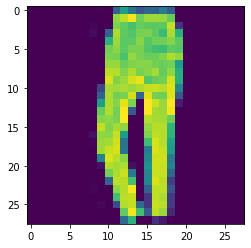

In [ ]:
for X,y in train_data.take(1):
  plt.imshow(X[4]);

### Including a preprocessing layer to standardize each input feature. Try to make the input pipeline as efficient as possible, using TensorBoard to visualize profiling data.

#### Include a preprocessing layer to standardize each input feature.

In [ ]:
class StandardizeLayer(tf.keras.layers.Layer):
  def adapt(self,data_sample):
    self.mean = np.mean(data_sample,axis=0,keepdims=True)
    self.std = np.std(data_sample,axis=0,keepdims=True)
    
  def call(self,inputs):
    x = (inputs-self.mean)/(self.std + tf.keras.backend.epsilon())
    return tf.expand_dims(x,axis=-1)

In [ ]:
train_data.take(1)

<TakeDataset shapes: ((None, 28, 28), (None,)), types: (tf.uint8, tf.int64)>

In [ ]:
standardization = StandardizeLayer(input_shape=[28, 28])


sample_image_batches = train_data.take(100).map(lambda image, label: image)
sample_images = np.concatenate(list(sample_image_batches.as_numpy_iterator()),
                               axis=0).astype(np.float32)
standardization.adapt(sample_images)

In [ ]:
import datetime

model = tf.keras.Sequential([
    standardization,
    tf.keras.layers.Conv2D(32,3,activation='relu'),
    tf.keras.layers.MaxPooling2D(),
    tf.keras.layers.Conv2D(32,3,activation='relu'),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(20,activation='relu'),
    tf.keras.layers.Dense(10,activation='softmax')
])

logs = 'logs/dir/' + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tboard_callback = tf.keras.callbacks.TensorBoard(log_dir = logs,
                                                 histogram_freq = 1,
                                                 profile_batch = '500,520')

model.compile(
    optimizer = 'adam',
    loss = 'sparse_categorical_crossentropy',
    metrics = ['acc']
)

model.fit(
    train_data,
    epochs = 10,
    verbose = 1,
    shuffle = True,
    validation_data = valid_data,
    callbacks = [tboard_callback]
)

Epoch 1/10
860/860 [==============================] - 5s 6ms/step - loss: 17.0552 - acc: 0.7823 - val_loss: 33.7196 - val_acc: 0.8850
Epoch 2/10
860/860 [==============================] - 5s 5ms/step - loss: 13.5949 - acc: 0.8884 - val_loss: 4.4663 - val_acc: 0.9010
Epoch 3/10
860/860 [==============================] - 5s 6ms/step - loss: 2.4564 - acc: 0.9048 - val_loss: 0.5793 - val_acc: 0.9066
Epoch 4/10
860/860 [==============================] - 5s 6ms/step - loss: 1.8102 - acc: 0.9170 - val_loss: 0.2591 - val_acc: 0.9058
Epoch 5/10
860/860 [==============================] - 5s 6ms/step - loss: 0.2018 - acc: 0.9275 - val_loss: 0.2520 - val_acc: 0.9136
Epoch 6/10
860/860 [==============================] - 5s 6ms/step - loss: 0.1813 - acc: 0.9330 - val_loss: 0.2550 - val_acc: 0.9150
Epoch 7/10
860/860 [==============================] - 5s 6ms/step - loss: 0.1607 - acc: 0.9426 - val_loss: 0.2585 - val_acc: 0.9150
Epoch 8/10
860/860 [==============================] - 5s 6ms/step - loss:

In [ ]:
#!pip install -U tensorboard_plugin_profile

# Load the TensorBoard notebook extension.
%load_ext tensorboard
#The performance profile for this model is similar to the image below.


# Launch TensorBoard and navigate to the Profile tab to view performance profile
%tensorboard --logdir=logs

Output hidden; open in https://colab.research.google.com to view.

In [2]:
"""
Created on Sun Jan 17 13:47:21 2021

@author: guilhermeviveiros


In this exercise you will download a dataset, 
split it, create a tf.data.Dataset to load it and preprocess it efficiently, 
then build and train a binary classification model containing an Embedding layer:

- Download the Large Movie Review Dataset, which contains 50,000 movies reviews 
from the Internet Movie Database. The data is organized in two directories,
 train and test, each containing a pos subdirectory with 12,500 positive 
 reviews and a neg subdirectory with 12,500 negative reviews. Each review is stored in a separate text file.
 There are other files and folders (including pre‐ processed bag-of-words),
 but we will ignore them in this exercise.
 
"""

import pandas as pd
import os
import random
import tensorflow as tf

In [3]:
#a) Download the data
def download_data():
    !wget http://ai.stanford.edu/~amaas/data/sentiment/aclImdb_v1.tar.gz
    !tar -xzf 'aclImdb_v1.tar.gz'
    
download_data()

--2021-01-25 20:13:21--  http://ai.stanford.edu/~amaas/data/sentiment/aclImdb_v1.tar.gz
Resolving ai.stanford.edu (ai.stanford.edu)... 171.64.68.10
Connecting to ai.stanford.edu (ai.stanford.edu)|171.64.68.10|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 84125825 (80M) [application/x-gzip]
Saving to: ‘aclImdb_v1.tar.gz’

aclImdb_v1.tar.gz   100%[===================>]  80.23M  9.68MB/s    in 85s     

2021-01-25 20:14:47 (962 KB/s) - ‘aclImdb_v1.tar.gz’ saved [84125825/84125825]



In [6]:
#b) Split the test set into a validation set (15,000) and a test set (10,000).

filepaths =  [os.path.join('aclImdb/train/pos',i) for i in os.listdir('aclImdb/train/pos')] +  [os.path.join('aclImdb/train/neg',i) for i in os.listdir('aclImdb/train/neg')]
test_filepaths = [os.path.join('aclImdb/test/pos',i) for i in os.listdir('aclImdb/test/pos')] +  [os.path.join('aclImdb/test/neg',i) for i in os.listdir('aclImdb/test/neg')]

random.shuffle(filepaths)
random.shuffle(test_filepaths)

train_filepaths = filepaths[:15000]
val_filepaths = filepaths[15000:]


In [7]:
#c) Use tf.data to create an efficient dataset for each set.

def parse_file(file_path):
  with open(file_path) as f:
    text = f.read()
  
  rating = int (file_path.split('/')[-1].split('_')[1].split('.')[0])

  return text,rating

def make_TfData(filepaths):

  reviews , labels = [],[]
    
  for file_path in filepaths:
        
    if('.ipynb_checkpoints' not in file_path):
      text, rating = parse_file(file_path)
      if(rating > 5):
        labels.append(1)
      else:
        labels.append(0)
      reviews.append(text)
    
  return tf.data.Dataset.from_tensor_slices(
    (tf.constant(reviews),
    tf.constant(labels))
  )

import sys
sys.setrecursionlimit(20000) #This way I can read all the files
print(sys.getrecursionlimit())

train_dataset = make_TfData(train_filepaths).shuffle(3000).batch(64).prefetch(1)
val_dataset = make_TfData(val_filepaths).shuffle(3000).batch(64).prefetch(1)
test_dataset = make_TfData(test_filepaths).shuffle(3000).batch(64).prefetch(1)

20000


d) Create a multi-classification model, using a TextVectorization layer to preprocess each review. If the TextVectorization layer is not yet available (or if you like a challenge), try to create your own custom preprocessing layer: you can use the functions in the tf.strings package, for example lower() to make everything lowercase, regex_replace() to replace punctuation with spaces, and split() to split words on spaces. You should use a lookup table to output word indices, which must be prepared in the adapt() method.

so basically now every sentence has one output, it's according classification with 0-10 range.

I'll try to preprocess each data with 2 methods:

1) TextVectorization Layer\
2) Tokenizers\
3) Custom one

In [9]:
#1) TextVectorization Layer
import numpy as np
sample = train_dataset.take(300).map(lambda text, label : text)
sample = np.concatenate(list(sample.as_numpy_iterator()),axis=0)

preprocess = tf.keras.layers.experimental.preprocessing.TextVectorization(
    max_tokens = 1000, #in this case no limit to the size of vocabulary
    output_mode='int', #encode to int, every word to int
    pad_to_max_tokens=True, #pad to the max setence,e.g. the max review in term of words
    output_sequence_length= 40,
    split='whitespace' #split the string on whitespaces
) 

#It's a Preprocessing layer, so I have to call its adpat method to update variables according to sample data
preprocess.adapt(sample)


model = tf.keras.models.Sequential([
  tf.keras.Input(shape=(1), dtype=tf.string), #the type needs to be string, because of this preprocessing layer that I'm adding now
  preprocess,
  tf.keras.layers.Embedding(input_dim=1000,output_dim=128,input_length=40, embeddings_regularizer=tf.keras.regularizers.L2()),
  tf.keras.layers.LSTM(32,return_sequences=True),
  tf.keras.layers.LSTM(64,return_sequences=False),
  tf.keras.layers.Flatten(),
  tf.keras.layers.Dense(64,activation='relu'),
  tf.keras.layers.Dense(32,activation='relu'),
  tf.keras.layers.Dense(1 ,activation='sigmoid'),
])

model.summary()


model.compile(
    optimizer = 'adam',
    loss = 'binary_crossentropy',
    metrics = ['acc']
)

model.fit(
    train_dataset,
    epochs = 1,
    validation_data = val_dataset,
    verbose = 1
)

model.evaluate(test_dataset)

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
text_vectorization (TextVect (None, 40)                0         
_________________________________________________________________
embedding (Embedding)        (None, 40, 128)           768000    
_________________________________________________________________
lstm (LSTM)                  (None, 40, 32)            20608     
_________________________________________________________________
lstm_1 (LSTM)                (None, 64)                24832     
_________________________________________________________________
flatten (Flatten)            (None, 64)                0         
_________________________________________________________________
dense (Dense)                (None, 64)                4160      
_________________________________________________________________
dense_1 (Dense)              (None, 32)                2

[0.6931678652763367, 0.5]

In [94]:
#Tokenizer its a preprocessing function, not defined as a layer within tensorflow

from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences 

In [88]:
sample = train_dataset.take(300).map(lambda text, label : text)
sample = np.concatenate(list(sample.as_numpy_iterator()),axis=0)

tokenizer = Tokenizer(num_words = 1000, oov_token = '#$!', lower = True, split=' ')
tokenizer.fit_on_texts([i.decode("utf-8")  for i in sample])
word_index = tokenizer.index_word

text = tokenizer.texts_to_sequences([i.decode("utf-8")  for i in sample])

words_per_sentence = [len(i) for i in text]

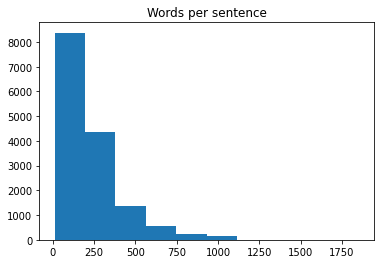

In [95]:
plt.title("Words per sentence")
plt.hist(words_per_sentence);

In [108]:
def preprocess(sentence,tokenizer=tokenizer):
  max_len = 250
  print("HERE")
  x = tf.compat.as_str_any(sentence)
  print("HER3")
  print(x)
  tokenized_text = tokenizer.fit_on_texts(x)
  text_padded = pad_sequences(tokenized_text, maxlen = max_len, padding = 'pre')

  return text_padded

 ## One can not use Tokenizer as part of data.Dataset API since this preprocessing Tokenizer step runs in eager mode..
### One cannot iterate a tensor in graph mode like tokenizer.fit_on_texts(x) needs

train_dataset = train_dataset.map(lambda x,y : preprocess(x)